In [8]:
#!/usr/bin/env python3

from models import *
from utils import *
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import sys
import time
import pdb
import argparse
import os
import shutil
import time
import cv2
from scipy import misc
from collections import defaultdict

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.distributed as dist
import torch.optim
import torch.utils.data
import torch.utils.data.distributed
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models

def vis_layer(activ_map):
    plt.clf()
    plt.subplot(221)
    plt.imshow(activ_map[:,:,0], cmap='gray')

def decon_img(layer_output):
    raw_img = layer_output.data.numpy()[0].transpose(1,2,0)
    img = (raw_img-raw_img.min())/(raw_img.max()-raw_img.min())*255
    img = img.astype(np.uint8) #here
    return img

def decon_img_new(layer_output):
    raw_img = layer_output.data.numpy()[0]
#     raw_img[0] = (raw_img[0] - np.mean(raw_img[0]))/np.std(raw_img[0])
#     raw_img[1] = (raw_img[1] - np.mean(raw_img[1]))/np.std(raw_img[1])
#     raw_img[2] = (raw_img[2] - np.mean(raw_img[2]))/np.std(raw_img[2])
#     raw_img[0] = raw_img[0] * 0.229 + 0.485
#     raw_img[1] = raw_img[1] * 0.224 + 0.456
#     raw_img[2] = raw_img[2] * 0.225 + 0.406
    raw_img[0] = (raw_img[0]-raw_img[0].min())/(raw_img[0].max()-raw_img[0].min())
    raw_img[1] = (raw_img[1]-raw_img[1].min())/(raw_img[1].max()-raw_img[1].min())
    raw_img[2] = (raw_img[2]-raw_img[2].min())/(raw_img[2].max()-raw_img[2].min())
    #raw_img *= 255
    #raw_img = raw_img.astype(np.uint8) #here
    return raw_img.transpose(1,2,0)

def logPolar_transform(image):
    M = 44.2244 # for 224 * 224 sized image
    img = np.array(image)
    return cv2.logPolar(img, (img.shape[0]/2, img.shape[1]/2), M, cv2.INTER_LINEAR+cv2.WARP_FILL_OUTLIERS)

def inverse_logPolar_transform(image):
    M = 44.2244 # for 224 * 224 sized image
    img = np.array(image)
    return cv2.logPolar(img, (img.shape[0]/2, img.shape[1]/2), M, cv2.INTER_LINEAR+cv2.WARP_FILL_OUTLIERS+cv2.WARP_INVERSE_MAP)

In [2]:
n_classes = 1000 # using ImageNet pretrained weights
vgg16_c = VGG16_conv(n_classes, True)
vgg16_c.cuda()

valdir = '../../data/imagenet_data/val/'
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

val_loader = torch.utils.data.DataLoader(
    datasets.ImageFolder(valdir, transforms.Compose([
        transforms.Scale(256),
        transforms.CenterCrop(224),
        transforms.Lambda(lambda x: logPolar_transform(x)),
        transforms.ToTensor(),
        normalize,
    ])),
    batch_size=32, shuffle=False,
    num_workers=4, pin_memory=True)

print('VGG16 model:')
print(vgg16_c)

#plt.ion() # remove blocking

vgg16_d = VGG16_deconv()
vgg16_d.cuda()

VGG16 model:
VGG16_conv (
  (features): Sequential (
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU ()
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU ()
    (4): MaxPool2d (size=(2, 2), stride=(2, 2), dilation=(1, 1))
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU ()
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU ()
    (9): MaxPool2d (size=(2, 2), stride=(2, 2), dilation=(1, 1))
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU ()
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU ()
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU ()
    (16): MaxPool2d (size=(2, 2), stride=(2, 2), dilation=(1, 1))
    (17): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (18): ReLU 

VGG16_deconv (
  (deconv_features): Sequential (
    (0): MaxUnpool2d (size=(2, 2), stride=(2, 2), padding=(0, 0))
    (1): ConvTranspose2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (2): ConvTranspose2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ConvTranspose2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): MaxUnpool2d (size=(2, 2), stride=(2, 2), padding=(0, 0))
    (5): ConvTranspose2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ConvTranspose2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ConvTranspose2d(512, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): MaxUnpool2d (size=(2, 2), stride=(2, 2), padding=(0, 0))
    (9): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): ConvTranspose2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(

In [3]:
l_n_f = []
for i in range(20):
    l_n_f += [(7,i*6 + 1)]
#print (l_n_f)
#l_n_f = [(0,61),(2,14), (5,56), (7,1), (10,209), (12,163), (14,32), (17,99), (19,144), (21,289), (24,390), (26,450), (28,500)]
activation_maps_list = defaultdict(list)

In [4]:
start = time.time()
for i, (input, target) in enumerate(val_loader):
    input_var = torch.autograd.Variable(input).cuda()
    start = time.time()
    # compute output
    print (i)
    output = vgg16_c.get_activation_l_n_f(input_var, l_n_f)
    for j,x in enumerate(l_n_f):
        activation_maps = np.sum(output[j].cpu().data.numpy(), axis = (1,2))
        activation_maps_list[j] += activation_maps.tolist()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

0 (7, 1)


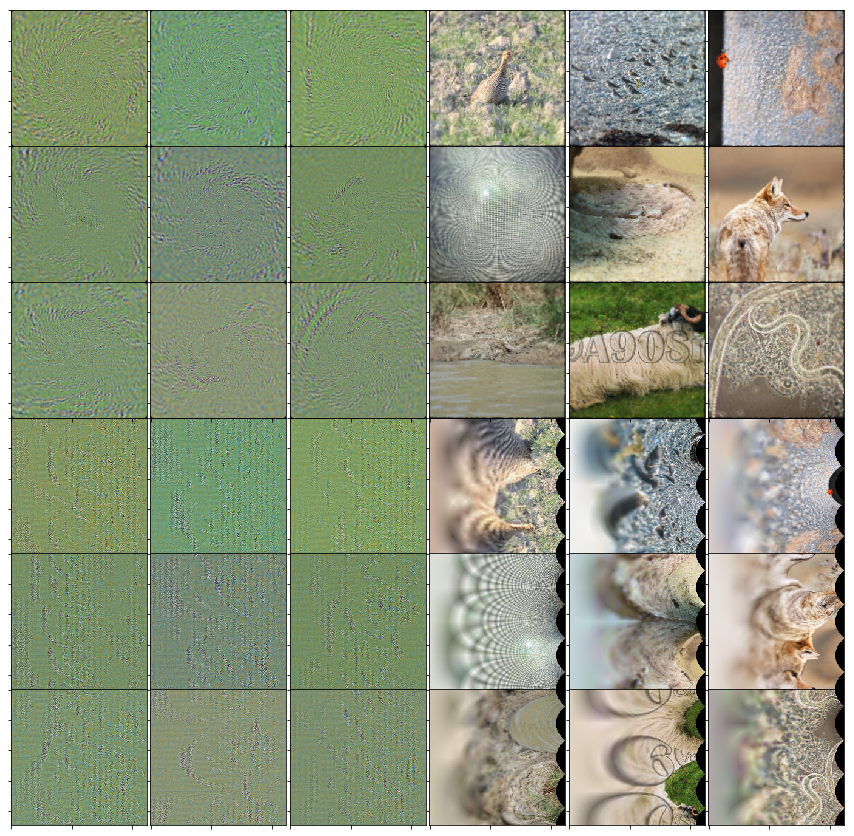

1 (7, 7)


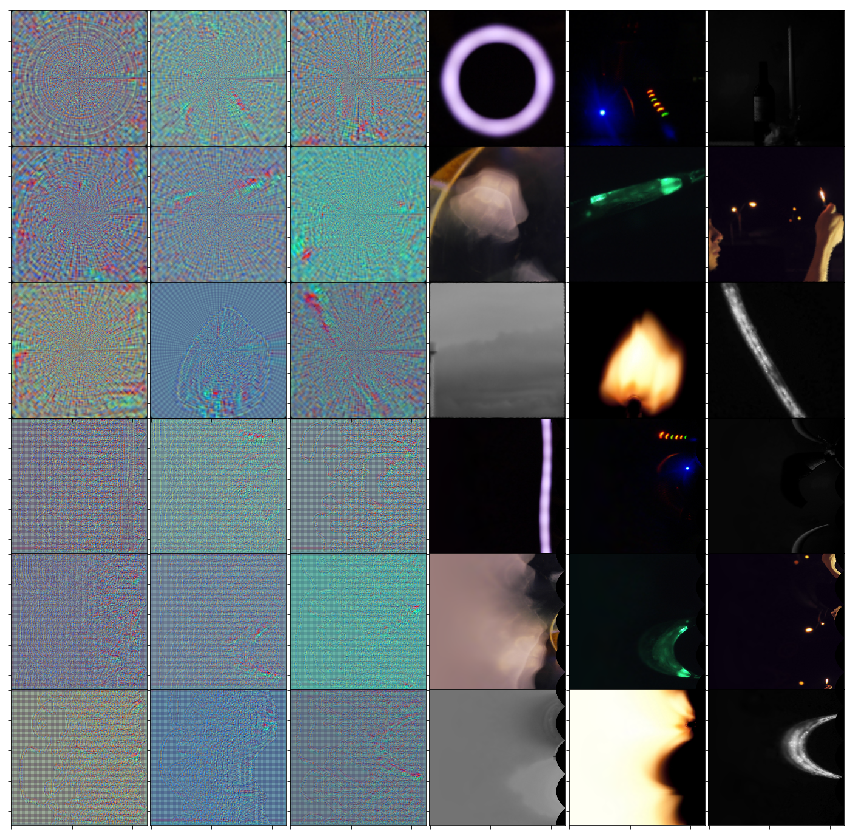

2 (7, 13)


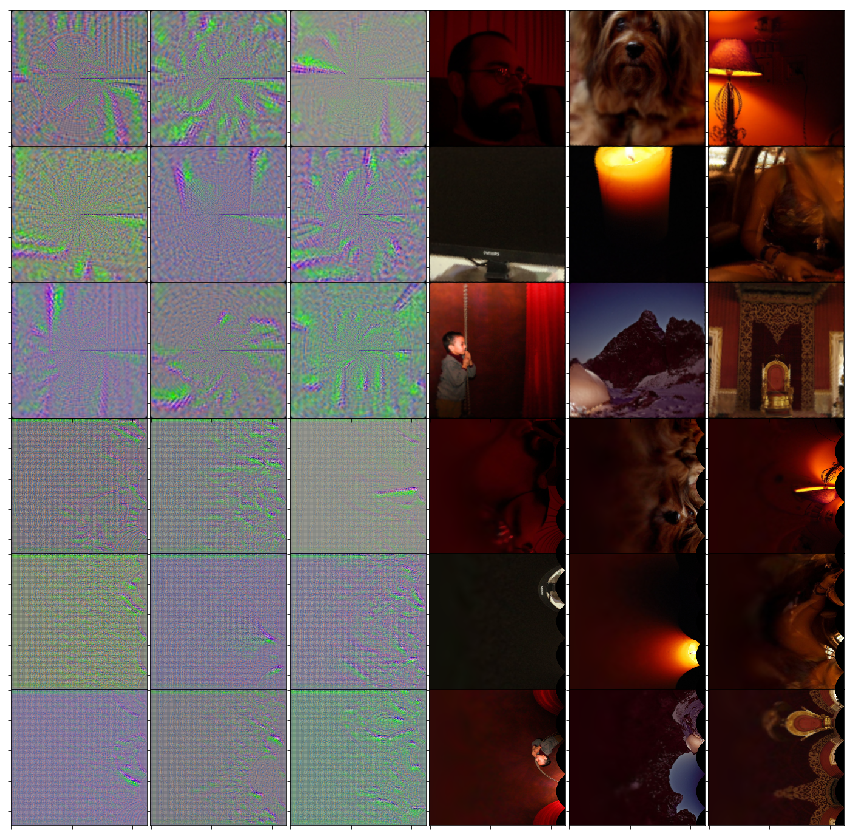

3 (7, 19)


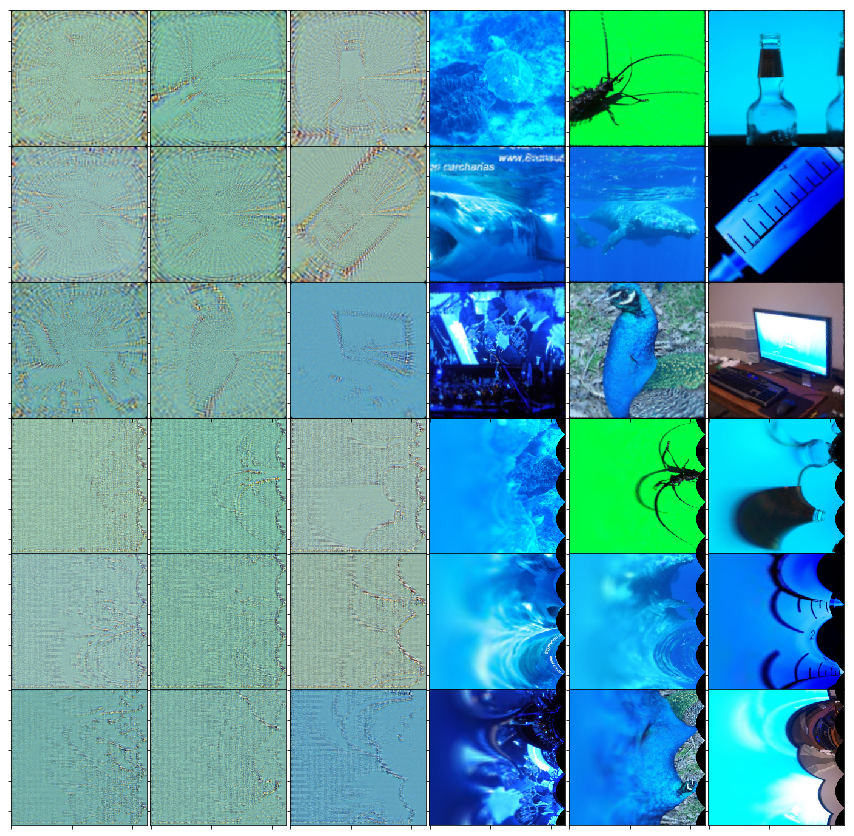

4 (7, 25)


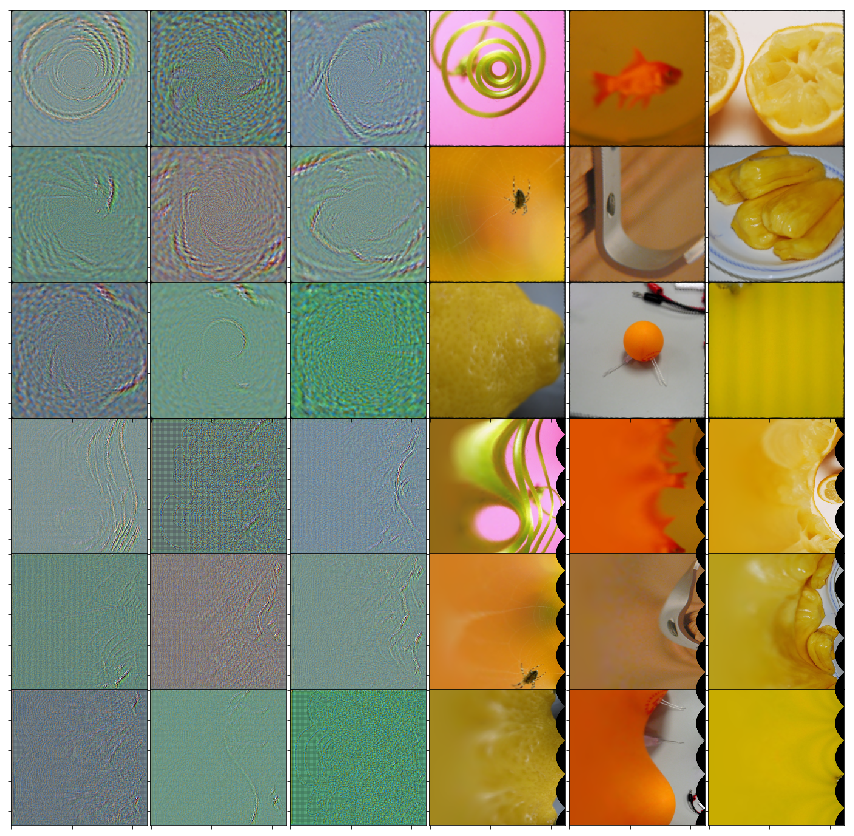

5 (7, 31)


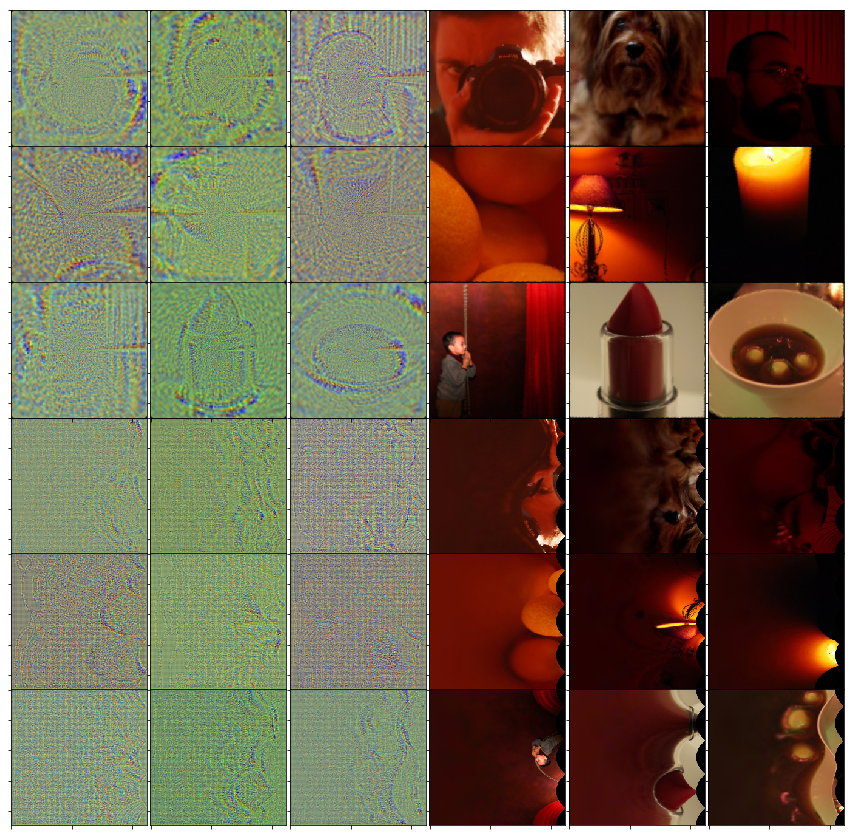

6 (7, 37)


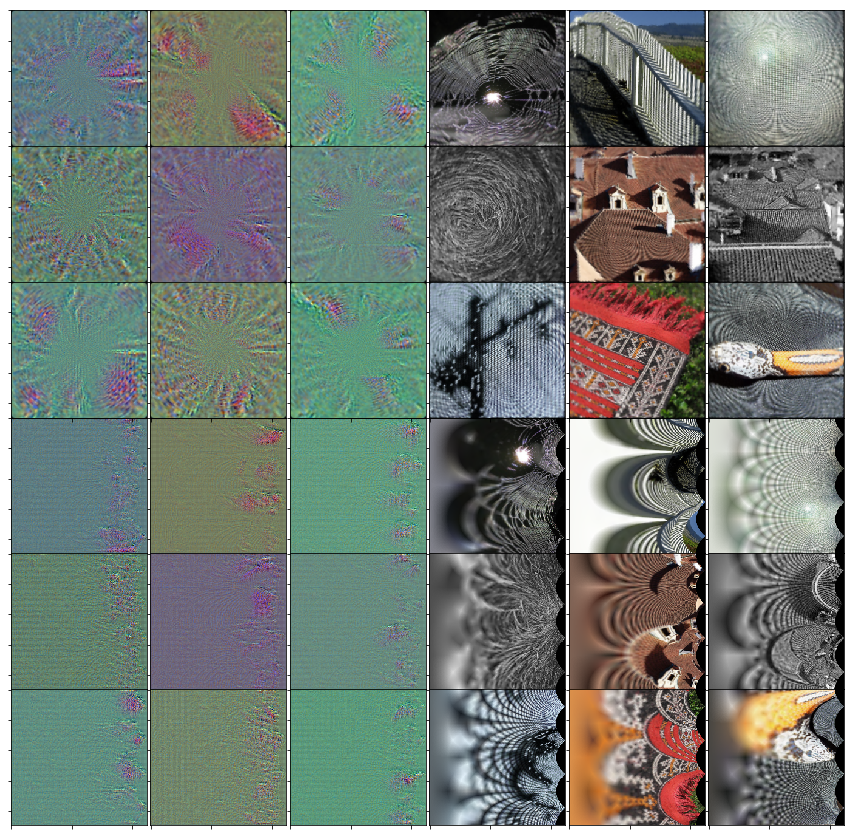

7 (7, 43)


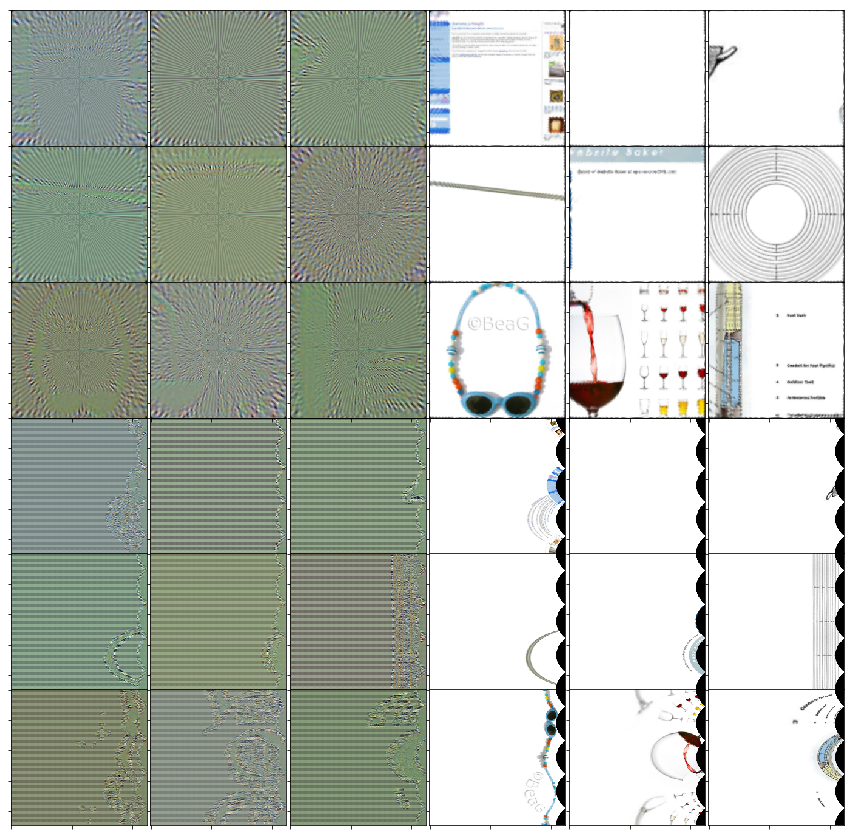

8 (7, 49)


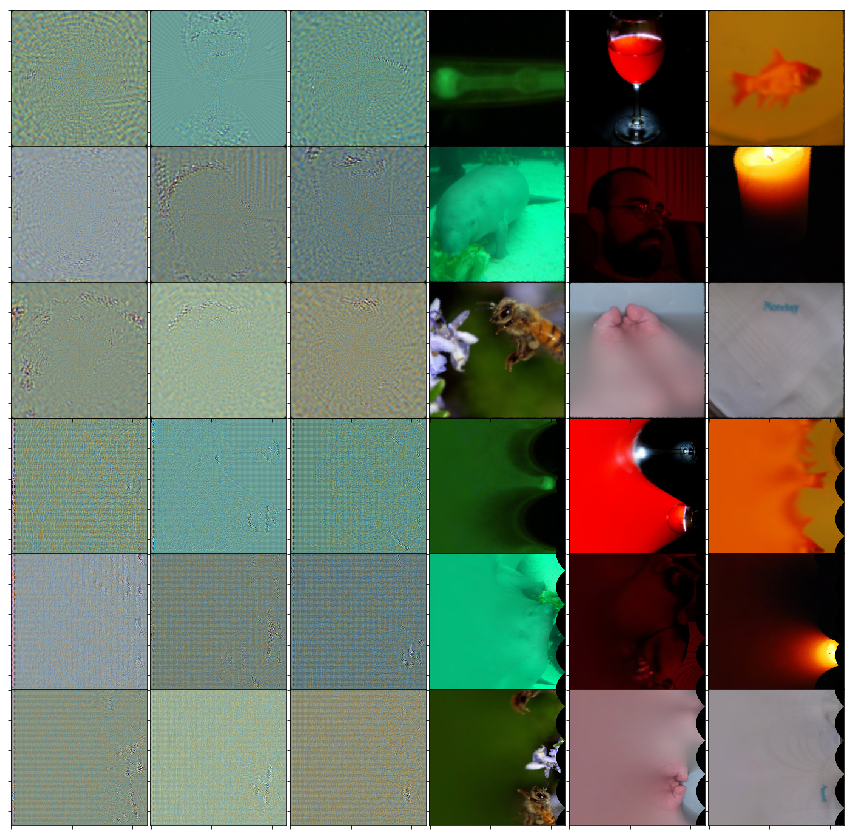

9 (7, 55)


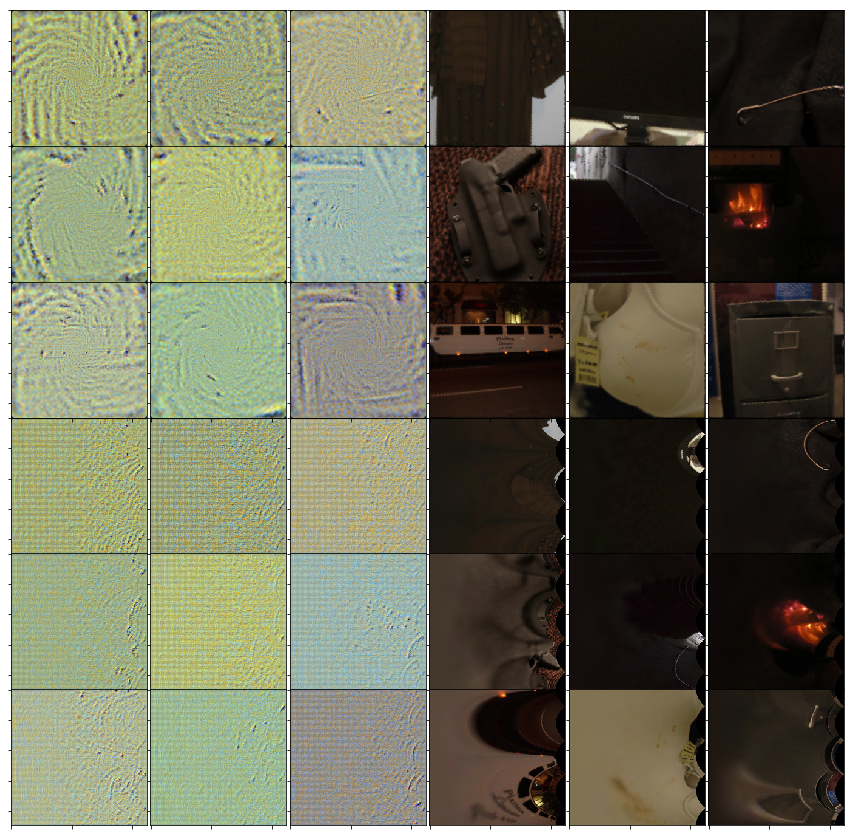

10 (7, 61)


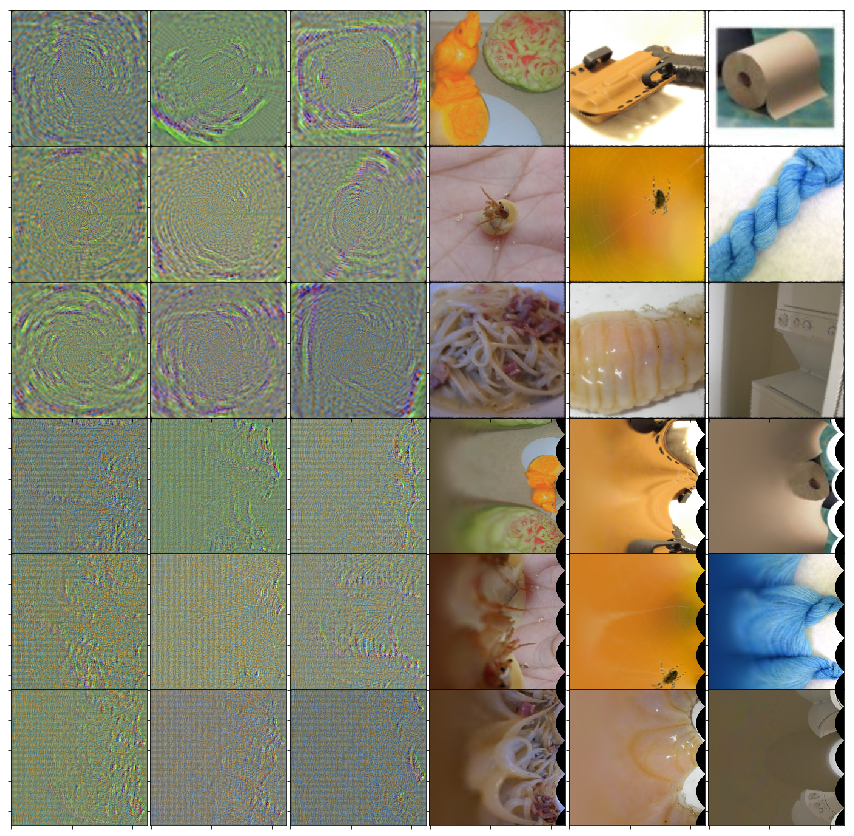

11 (7, 67)


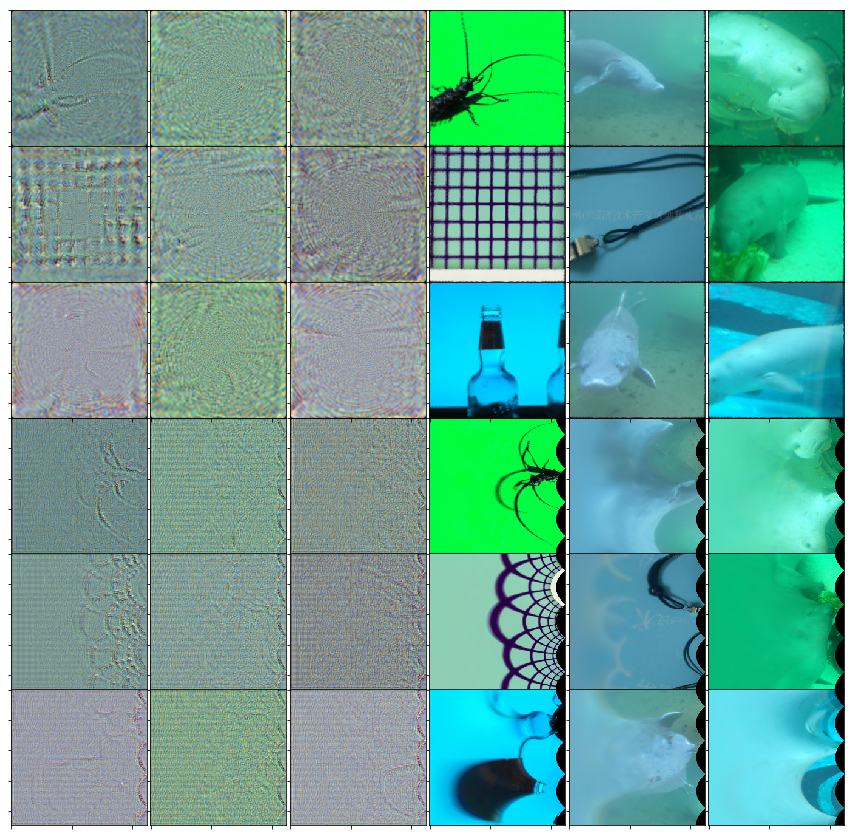

12 (7, 73)


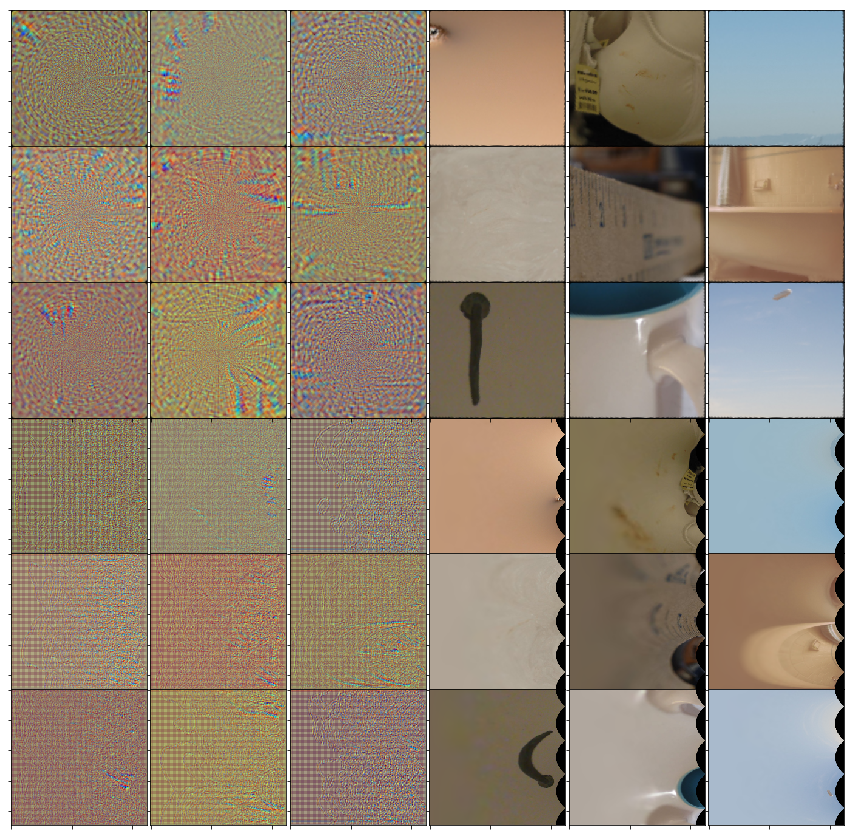

13 (7, 79)


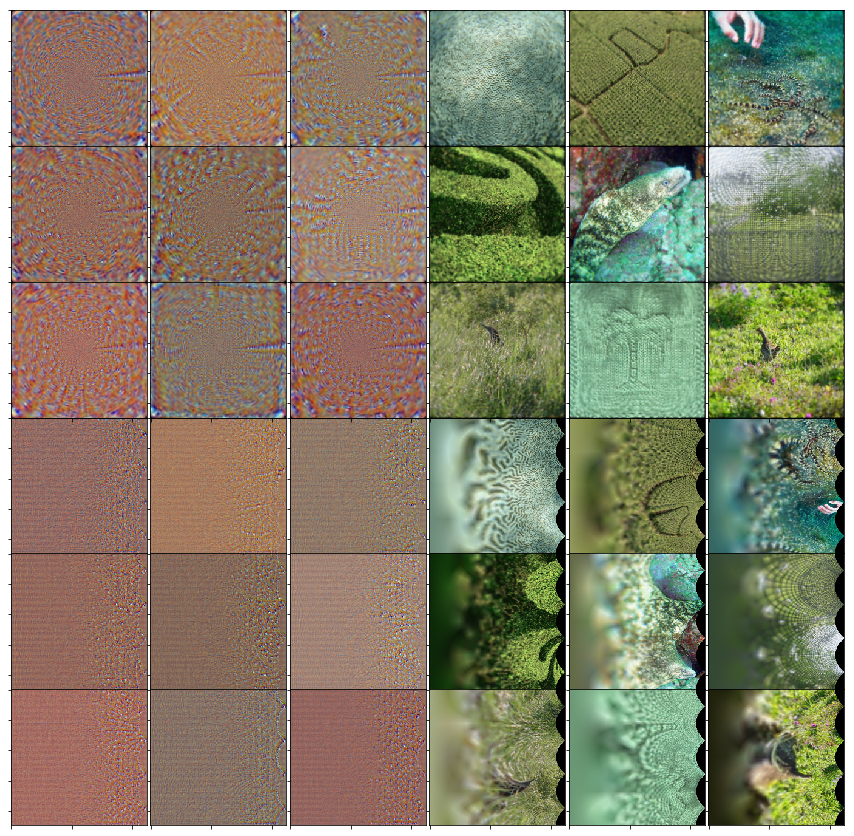

14 (7, 85)


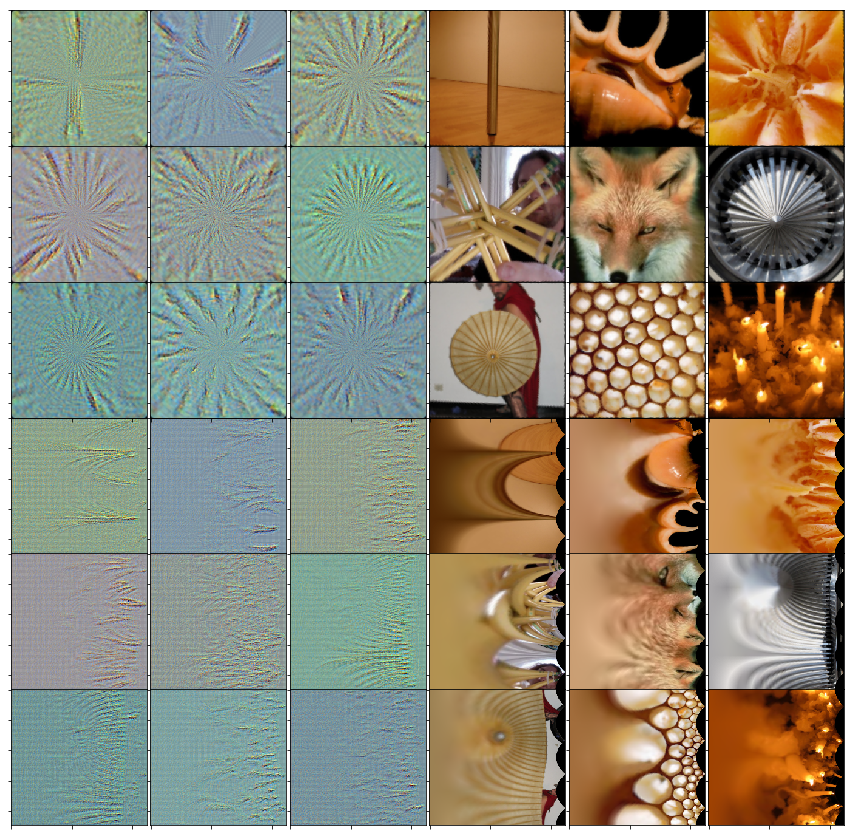

15 (7, 91)


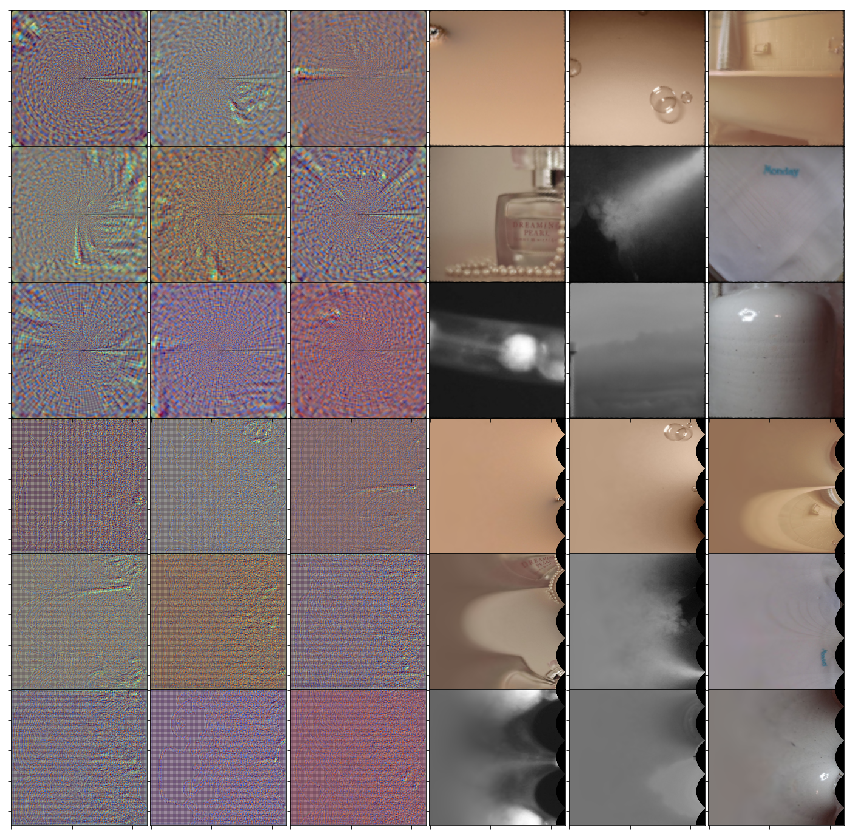

16 (7, 97)


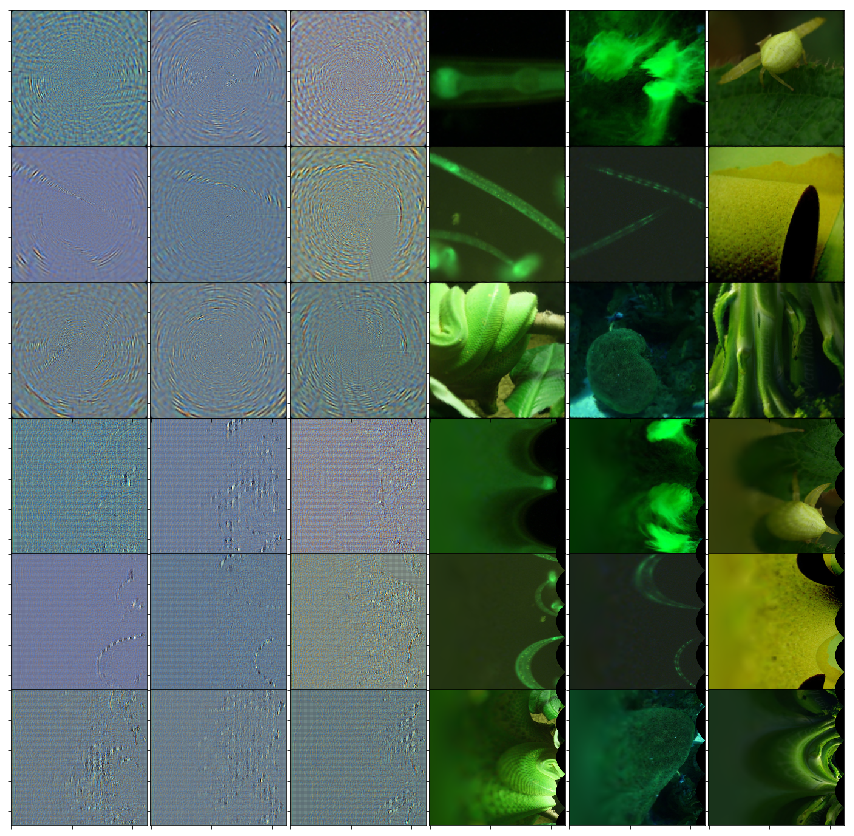

17 (7, 103)


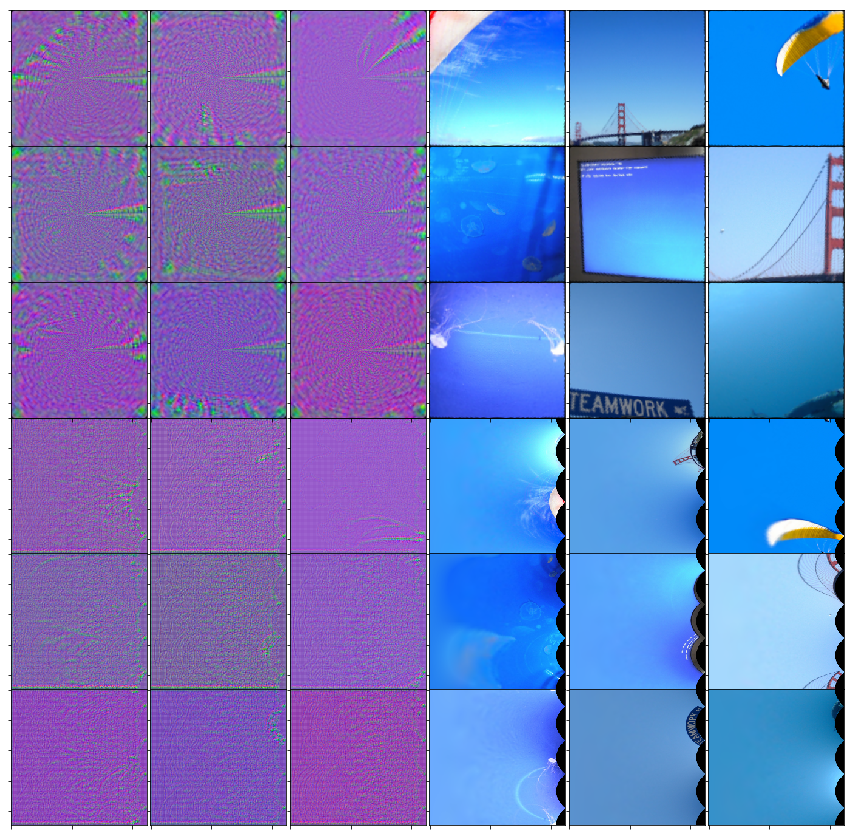

18 (7, 109)


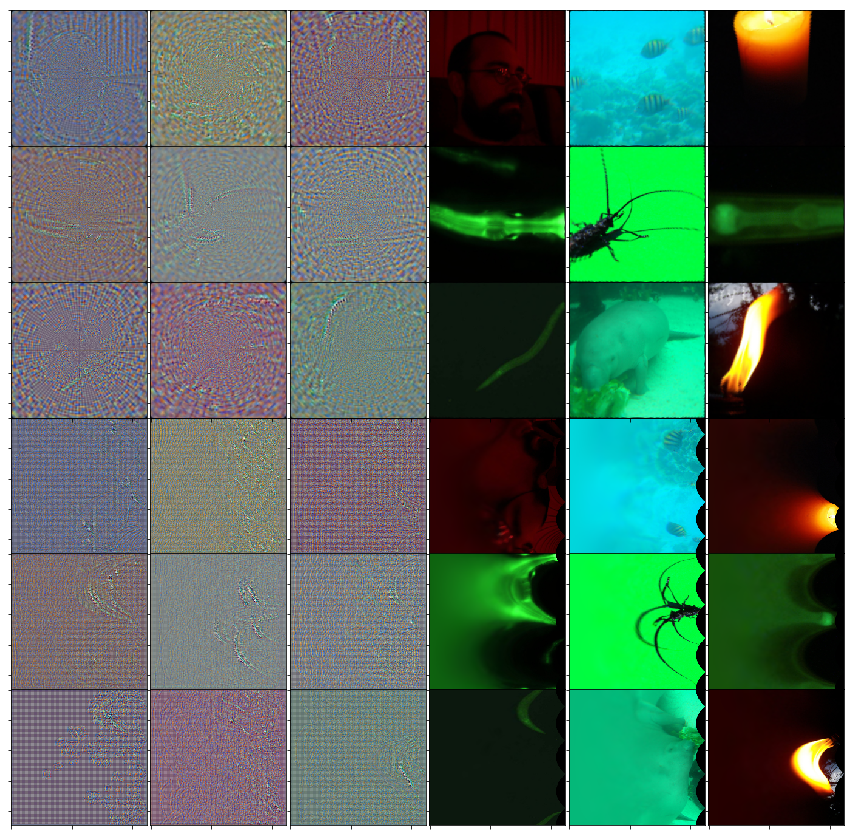

19 (7, 115)


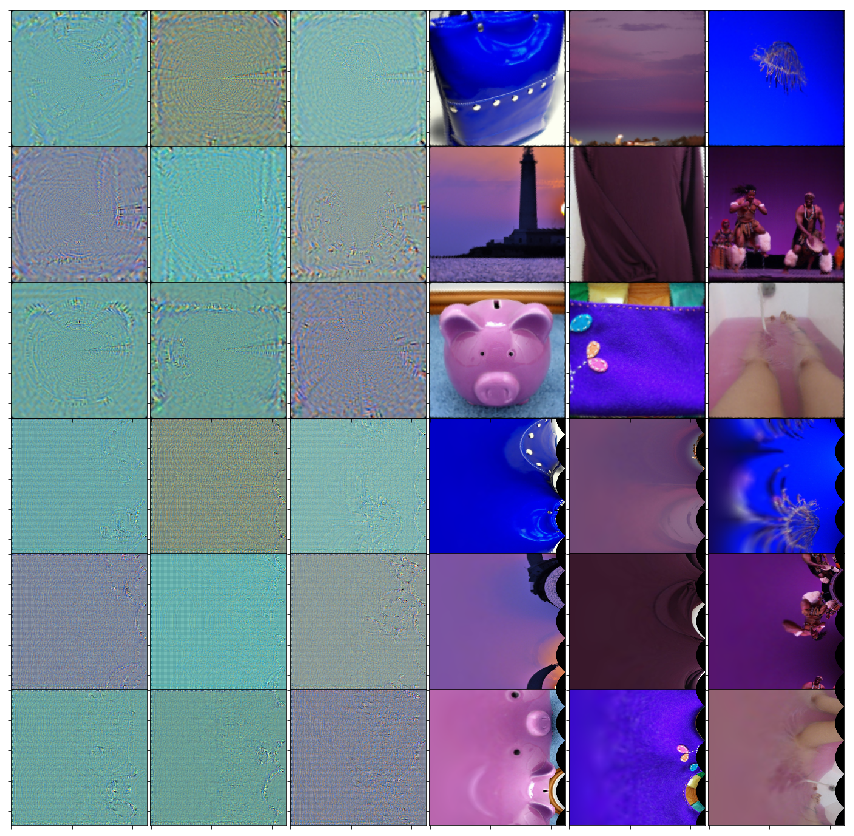

In [9]:
#pdb.set_trace()
plt.clf()
for j,y in enumerate(l_n_f):
    plt.figure(figsize=(15,15))
    ax = []
    activation_maps = np.array(activation_maps_list[j])
    i_sort = np.argsort(activation_maps)
    top_9 = i_sort[-9:]

    for i,x in enumerate(top_9[::-1]):
        img_filename = val_loader.dataset.imgs[x][0]
        img = Image.open(img_filename)
        img = img.convert('RGB')
        img_temp_1 = transforms.Compose([
            transforms.Scale(256),
            transforms.CenterCrop(224),
            transforms.Lambda(lambda x: logPolar_transform(x)),
            ])(img)
        img_temp_2 = transforms.Compose([
            transforms.ToTensor(),
            normalize,
            ])(img_temp_1)
        img = np.array(img_temp_1)
        img_var = torch.autograd.Variable(img_temp_2.unsqueeze(0)).cuda()
        conv_out = vgg16_c(img_var)
        decon = vgg16_d(vgg16_c.feature_outputs[l_n_f[j][0]][0][l_n_f[j][1]][None,None,:,:], l_n_f[j][0], l_n_f[j][1], vgg16_c.pool_indices)
        img_1 = decon_img_new(decon.cpu())
        #img_2 = decon_img(F.relu(decon).cpu())
        ind = (i//3)*6 + (i%3) + 1
        ax += [plt.subplot(6,6, ind)]
        plt.imshow(inverse_logPolar_transform(img_1))
        ax += [plt.subplot(6,6, 18 + ind)]
        plt.imshow(img_1)
        ax += [plt.subplot(6,6, ind + 3)]
        plt.imshow(np.asarray(inverse_logPolar_transform(img_temp_1)))
        ax += [plt.subplot(6,6, 18 + ind + 3)]
        plt.imshow(np.asarray(img_temp_1))

    for a in ax:
        a.set_xticklabels([])
        a.set_yticklabels([])
        a.set_aspect('equal')
    plt.subplots_adjust(wspace=0, hspace=0)
    print(j, y)
    plt.show()

In [ ]:
#np.sum(output.dacontinueta.numpy()[1])
#type(output[1][7])
#output[2][4].size() ([2, 64, 112, 112])
#val_loader.dataset.imgs[:10] ('../../data/imagenet_data/val/n01440764/ILSVRC2012_val_00000293.JPEG', 1)

In [ ]:
a = {}

In [ ]:
a = {}


In [ ]:
a[0] = 9

In [ ]:
a